In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
from scipy import stats
from collections import OrderedDict
from aisynphys.database import default_db as db
from aisynphys.cell_class import CellClass, classify_cells, classify_pairs
from aisynphys.connectivity import connectivity_profile, GaussianModel, CorrectionModel, BinaryModel, ErfModel, connection_probability_ci, CorrectionMetricFunctions, get_cp_results, adjust_cp, get_correction_model, pair_was_probed
from aisynphys.ui.notebook import show_connectivity_profile, show_distance_binned_cp, show_connectivity_raster, show_connectivity_fit, set_distance_xticks, show_connectivity_matrix, compose_svg_figure
import warnings; warnings.simplefilter('ignore')
print(db.schema_version)

21


Start by reproducing detection power result from S1D and decunstructing it to N presynaptic spikes and postsynaptic noise stdev

In [158]:
correction_metrics = {
    'detection_power': 
    {'ymax': 0.3, 
     'xbins': np.arange(3.4, 5.21, 0.2), 
     'alpha': [0.01, 0.1], 
     'units': 'a.u.', 
     'scale': 1, 
     'label': 'Log10 detection power',
     'model': ErfModel,
    'model_opts':{
     'init': (0.1, 1.0, 3.0), 
     'bounds': ((0.001, 1), (0.1, 5), (2, 5)), 
#      'constraint': (0.6745, np.nanquantile(detection_power, 0.75))} # this will get updated once we calculate it
    }
    },
    
    'n_test_spikes':
    {'ymax': 0.2, 
    'xbins': np.arange(0, 800, 100), 
    'alpha': [0.01, 0.1],
    'units': '#', 
    'scale': 1,
    'label': 'Pre-syn spikes', 
    'model': ErfModel,
    'model_opts': {
     'init': (0.05, 1000, 300), 
    'bounds': ((0.001, 1), (10, 10e3), (10, 500)),
    'constraint': (0.6745, 500) #this is a full dataset
    }
    },
    
    'baseline_noise_stdev':
    {'ymax': 0.2, 
     'xbins': np.arange(0.2e-3, 1.8e-3, 0.2e-3), 
     'alpha': [0.005, 0.05], 
     'units': 'mV', 
     'scale': 1e3, 
     'label': 'Post-syn IC noise', 
     'model': GaussianModel,
     'model_opts':{
     'init': (0.05, 0.5e-3), 
     'bounds': ((0.001, 1),(0.2e-3, 3e-3)), 
     }
    },
}

In [4]:
# select all excitatory / inhibitory pairs
projects = ['mouse V1 coarse matrix', 'mouse V1 pre-production']
mouse_pairs = db.pair_query(project_name=projects).all()
print("loaded %d cell pairs" % len(mouse_pairs))

# filter pairs on several criteria:
def check_pair(p, syn_type):
    return (
        # must have been probed for connectivity
        pair_was_probed(p, syn_type) and
        # must have a true/false connection call
        p.has_synapse is not None and
        # intersomatic distance < 500 µm (removes some bad data with very large distances)
        p.lateral_distance is not None and 
        p.lateral_distance < 500e-6
    )

attributes = list(correction_metrics.keys())
extended_pairs = []
for pair in mouse_pairs:
    probe_type = pair.pre_cell.cell_class_nonsynaptic
    if probe_type not in ['ex', 'in']:
        continue
    if not check_pair(pair, probe_type):
        continue
    for attr in attributes:
        if hasattr(pair, attr):
            continue
        attr_func = getattr(CorrectionMetricFunctions, attr)
        val = attr_func(pair)
        setattr(pair, attr, val)
    
    extended_pairs.append(pair)
    

loaded 83006 cell pairs


In [5]:
# plotting functions

def plot_metric_profile(probed, conn, ax, metric_opts, color=(0.5, 0, 0)):
    # plot step histogram with confidence intervals
    ymax = metric_opts['ymax']
    tickheight = ymax / 10
    offset = 2
    x_bins = metric_opts['xbins']
    x_vals = np.linspace(x_bins[0], x_bins[-1], 200)
    
    _, cprop, lower, upper = connectivity_profile(conn, probed, x_bins)
    show_distance_binned_cp(x_bins, cprop, ax, ci_lower=lower, ci_upper=upper)
    
    alpha = metric_opts['alpha']
    ax.eventplot(probed.copy(), lineoffsets=-tickheight*offset, linelengths=tickheight, color=((0, 0, 0) + (alpha[0],)))
    ax.eventplot(probed[conn], lineoffsets=-tickheight*(offset-1), linelengths=tickheight, color=((0, 0, 0) + (alpha[1],)))
    ax.axhline(0, color=(0, 0, 0))
    
    interval = x_bins[1] - x_bins[0]
    xticks = np.arange(0, x_vals.max(), interval)
    ax.set_xticks(xticks)
    tick_labels = ['%0.1f'%(x*metric_opts['scale']) for x in xticks]
    trailing_zero = [label.strip('.')[-1] == '0' for label in tick_labels]
    if all(trailing_zero):
        tick_labels = ['%0.0f'%(x*metric_opts['scale']) for x in xticks] 
    ax.set_xticklabels(tick_labels, fontsize=8)
    ax.set_xlim(x_bins[0], x_bins[-1])
    
    y_vals = np.arange(0, ymax + 0.1, 0.1)
    ax.set_yticks([-tickheight*2, -tickheight] + list(y_vals))
    ax.set_yticklabels(['probed', 'connected'] + ['%0.1f'%x for x in y_vals], fontsize=8)
    ax.set_ylim(-tickheight*2.6, ymax)
    x_label = "%s (%s)" % (metric_opts['label'], metric_opts['units'])
    ax.set_xlabel(x_label, fontsize=8)
    
#     # fit metric model and plot
#     model = metric_opts['model']
#     model_opts = metric_opts['model_opts']
#     fit = model.fit(probed, conn, **model_opts)
#     ax.plot(x_vals, fit.connection_probability(x_vals), color=color, lw=2)
#     ax.axhline(fit.pmax, color=color, ls='--')
    
#     ax.spines['right'].set_visible(False)
#     ax.spines['top'].set_visible(False)


def metric_hist(metric_data, ax, opts={}):
    ax.hist(metric_data, color=(0.8, 0.8, 0.8))
    
    x_bins = opts['xbins']
    x_vals = np.linspace(x_bins[0], x_bins[-1], 200)
    
    interval = x_bins[1] - x_bins[0]
    xticks = np.arange(0, x_vals.max(), interval)
    ax.set_xticks(xticks)
    tick_labels = ['%0.1f'%(x*metric_opts['scale']) for x in xticks]
    trailing_zero = [label.strip('.')[-1] == '0' for label in tick_labels]
    if all(trailing_zero):
        tick_labels = ['%0.0f'%(x*metric_opts['scale']) for x in xticks] 
    
    ax.set_xticklabels(tick_labels, fontsize=8)
    ax.set_xlim(x_bins[0], x_bins[-1])
    
    x_label = "%s (%s)" % (opts['label'], opts['units'])
    ax.set_xlabel(x_label, fontsize=8)
    ax.set_ylabel('N pairs', fontsize=8)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

In [6]:
ei_classes = {'ex': CellClass(cell_class_nonsynaptic='ex', name='ex'), 
              'in': CellClass(cell_class_nonsynaptic='in', name='in')}
ei_cell_groups = classify_cells(ei_classes.values(), pairs=extended_pairs)
ei_pair_groups = classify_pairs(extended_pairs, ei_cell_groups)

# update detection power constraint
detection_power = np.array([getattr(p, 'detection_power') for p in extended_pairs], dtype=float)
correction_metrics['detection_power']['model_opts']['constraint'] = (0.6745, np.nanquantile(detection_power, 0.75))

ei_connectivity = OrderedDict()

for pair_group, pairs in ei_pair_groups.items():
    pre_class, post_class = pair_group
    
    cp_results = get_cp_results(pairs)
    
    fixed_sigma = 125e-6 if pre_class==post_class else 95e-6
#     correction_metrics['lateral_distance']['bounds'] = ((0.001, 1), (fixed_sigma, fixed_sigma))
    
    corr_models = get_correction_model(pairs, correction_metrics)
    cp_adjust = adjust_cp(pairs, corr_models['full_model'])
    
    ei_connectivity[pair_group] = cp_results
    ei_connectivity[pair_group]['corr_models'] = corr_models

Text(0, 0.5, 'Adjusted Connection Probability')

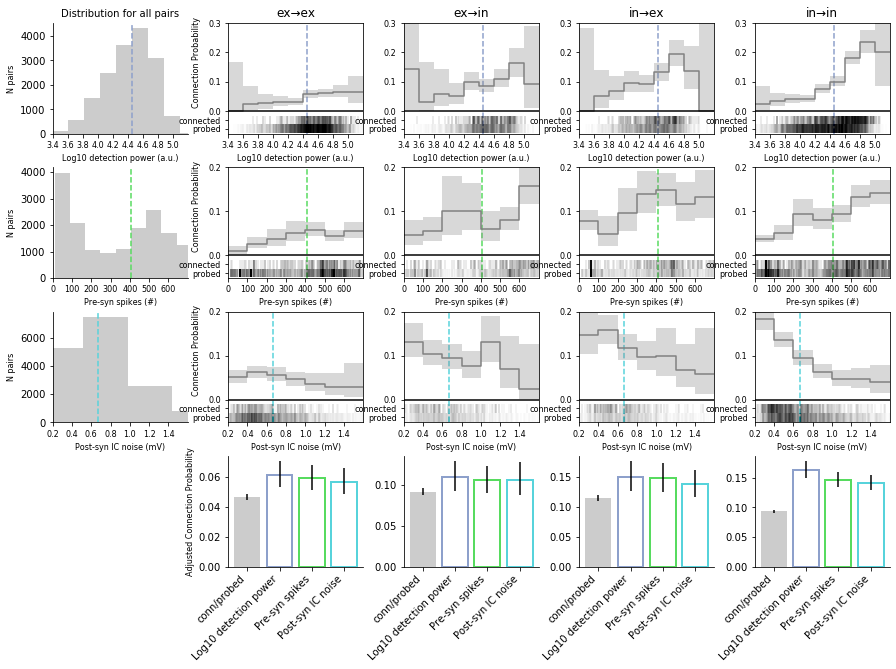

In [159]:
metrics_to_plot = ['detection_power', 'n_test_spikes', 'baseline_noise_stdev']

fit_results = pd.DataFrame(columns=['ei_class', 'metric', 'fit_type', 'pmax', 'ci_lower', 'ci_upper'])

figC, axs = plt.subplots(len(metrics_to_plot)+1, 5, figsize=(15,10))
plt.subplots_adjust(hspace=0.3, wspace=0.3)
colors = [sns.color_palette("Set2")[2], sns.color_palette('hls')[2], sns.color_palette('hls')[3]]
for i, (ei_class, results) in enumerate(ei_connectivity.items()):
    axs[0, i+1].set_title("%s→%s" % (ei_class[0], ei_class[1]), fontsize=12)
    pairs = results['probed_pairs']
    conn = np.array([p.has_synapse for p in pairs], dtype=bool)  
    bar_tick_labels = []
    cp, ci_lower, ci_upper = results['connection_probability']
    fit_results = fit_results.append({
        'ei_class': ei_class,
        'metric': 'None',
        'fit_type': 'None',
        'pmax': cp,
        'ci_lower': ci_lower,
        'ci_upper': ci_upper
        }, ignore_index=True)
    axs[-1, i+1].bar([0], [cp], yerr=[[cp - ci_lower], [ci_upper - cp]], color=(0.8, 0.8, 0.8))
    bar_tick_labels.append('conn/probed')

    
    for j, metric in enumerate(metrics_to_plot):
    
        color = colors[j]
        metric_opts = correction_metrics[metric]
        metric_data = np.array([getattr(p, metric) for p in extended_pairs], dtype=float)
        metric_mask = np.isfinite(metric_data)
        metric_data = metric_data[metric_mask]
        metric_thresh = np.nanquantile(metric_data, 0.5)
        
        if i==0:
            metric_hist(metric_data, axs[j, 0], opts=metric_opts)
            axs[j, 0].axvline(metric_thresh, ls='--', color=color)
                              
        probed = np.array([getattr(p, metric) for p in pairs], dtype=float)
        mask = np.isfinite(probed) & np.isfinite(conn)   
        
        axs[j, i+1].axvline(metric_thresh, ls='--', color=color, zorder=-100)
        plot_metric_profile(probed[mask], conn[mask], axs[j, i+1], metric_opts, color=color)
        
        if metric == 'baseline_noise_stdev':
            filt_metric = [p for p in pairs if getattr(p, metric) is not None and getattr(p, metric) <= metric_thresh]
        else:
            filt_metric = [p for p in pairs if getattr(p, metric) is not None and getattr(p, metric) >= metric_thresh]
        filt_conn = np.array([p.has_synapse for p in filt_metric], dtype=bool)
        filt_cp = sum(filt_conn) / len(filt_metric)
        filt_ci_lower, filt_ci_upper = connection_probability_ci(sum(filt_conn), len(filt_metric))
        fit_results = fit_results.append({
            'ei_class': ei_class,
            'metric': metric,
            'fit_type': 'filter',
            'pmax': filt_cp,
            'ci_lower': filt_ci_lower,
            'ci_upper': filt_ci_upper
        }, ignore_index=True)
        
        axs[-1, i+1].bar(j+1, filt_cp, yerr=[[filt_cp - filt_ci_lower], [filt_ci_upper - filt_cp]], edgecolor=color, 
                         linewidth=2, color='w')
        bar_tick_labels.append(metric_opts['label'])
    
    axs[-1, i+1].set_xticks(range(0, len(bar_tick_labels)))
    axs[-1, i+1].set_xticklabels(bar_tick_labels, rotation=45, ha='right')
#     axs[-1, i+1].set_yscale('log')
#     axs[-1, i+1].set_ylim(0, 0.5)
    
    axs[-1, i+1].spines['right'].set_visible(False)
    axs[-1, i+1].spines['top'].set_visible(False)
        
axs[-1, 0].axis("off")      

axs[0, 0].set_title('Distribution for all pairs', fontsize=10)
[axs[a, 1].set_ylabel('Connection Probability', fontsize=8) for a in range(0, len(metrics_to_plot))]
[axs[a, 1].yaxis.set_label_coords(-0.2, 0.65) for a in range(0, len(metrics_to_plot))]
axs[-1, 1].set_ylabel('Adjusted Connection Probability', fontsize=8)

In [8]:
def pmax_adjustment(row):
    ei_class = row['ei_class']
    unadjusted = fit_results[(fit_results['ei_class']==ei_class) & (fit_results['metric']=='None')]['pmax']
    adjustment = (row['pmax'] - unadjusted) / unadjusted * 100
    return adjustment.values[0]

fit_results['%change'] = fit_results.apply(lambda x: pmax_adjustment(x), axis=1)

fit_results

,ei_class,metric,fit_type,pmax,ci_lower,ci_upper,%change
0,"(ex, ex)",None,None,0.046450,0.044520,0.048486,0.000000
1,"(ex, ex)",detection_power,filter,0.061204,0.052943,0.070322,31.765213
2,"(ex, ex)",n_test_spikes,filter,0.059001,0.051229,0.067560,27.020836
3,"(ex, ex)",baseline_noise_stdev,filter,0.056239,0.048058,0.065347,21.075490
4,"(ex, in)",None,None,0.091600,0.087384,0.096057,0.000000
5,"(ex, in)",detection_power,filter,0.110052,0.092574,0.129545,20.144566
6,"(ex, in)",n_test_spikes,filter,0.105891,0.090394,0.123031,15.601546
7,"(ex, in)",baseline_noise_stdev,filter,0.106583,0.087744,0.127881,16.357520
8,"(in, ex)",None,None,0.115479,0.110580,0.120628,0.000000
9,"(in, ex)",detection_power,filter,0.150538,0.126979,0.176587,30.359186


Let's get some more info about these pairs, experiments, cells...

In [9]:
pair_dict = [p.__dict__ for p in extended_pairs]
pair_df = pd.DataFrame(pair_dict)
pair_df.drop(labels='_sa_instance_state', axis='columns', inplace=True)
pair_df['post_hs'] = pair_df.apply(lambda x: x['post_cell'].ext_id, axis=1)
pair_df['post_cell.cre_type'] = pair_df.apply(lambda x: x['post_cell'].cre_type, axis=1)
pair_df['post_cortical_cell_location.cortical_layer'] = pair_df.apply(lambda x: x['post_cell'].cortical_location.cortical_layer, axis=1)
pair_df['post_cell.cell_class_nonsynaptic'] = pair_df.apply(lambda x: x['post_cell'].cell_class_nonsynaptic, axis=1)
pair_df.head()

,id,crosstalk_artifact,experiment_id,n_ex_test_spikes,pre_cell_id,n_in_test_spikes,post_cell_id,distance,has_synapse,lateral_distance,...,pre_cell,post_cell,detection_power,n_test_spikes,baseline_noise_stdev,synapse,post_hs,post_cell.cre_type,post_cortical_cell_location.cortical_layer,post_cell.cell_class_nonsynaptic
0,18736,None,403,505,2865,0,2871,0.000047,False,0.000037,...,<Cell 1492545925.146 2>,<Cell 1492545925.146 8>,4.729260,505,0.000419,None,8,tlx3,5,ex
1,18748,None,403,445,2867,0,2865,0.000030,True,0.000025,...,<Cell 1492545925.146 4>,<Cell 1492545925.146 2>,4.692806,445,0.000428,<aisynphys.database.database.Synapse object at...,2,tlx3,5,ex
2,18753,None,403,445,2867,0,2868,0.000038,False,0.000036,...,<Cell 1492545925.146 4>,<Cell 1492545925.146 5>,4.930035,445,0.000248,None,5,tlx3,5,ex
3,18754,None,403,445,2867,0,2869,0.000033,False,0.000014,...,<Cell 1492545925.146 4>,<Cell 1492545925.146 6>,4.611829,445,0.000516,None,6,tlx3,5,ex
4,18757,None,403,110,2867,0,2870,0.000034,False,0.000027,...,<Cell 1492545925.146 4>,<Cell 1492545925.146 7>,3.814342,110,0.001608,None,7,tlx3,5,ex


In [10]:
cell_class_criteria = {
    'l23pyr': {'cell_class_nonsynaptic': 'ex', 'cortical_layer': '2/3'},
    'l4pyr':  {'cre_type': ('nr5a1', 'rorb'), 'cortical_layer': '4'},
    'l5et':   {'cre_type': ('sim1', 'fam84b'), 'cortical_layer': '5'},
    'l5it':   {'cre_type': 'tlx3', 'cortical_layer': '5'}, 
    'l6pyr':  {'cre_type': 'ntsr1', 'cortical_layer': ('6', '6a', '6b')},
    'pv':     {'cre_type': 'pvalb'},
    'sst':    {'cre_type': 'sst'},
    'vip':    {'cre_type': 'vip'},  
}

cell_classes = {name:CellClass(name=name, **criteria) for name,criteria in cell_class_criteria.items()}

In [11]:
from aisynphys.cell_class import classify_cell_dataframe

match = classify_cell_dataframe(cell_classes, pair_df, prefix='post_')

In [12]:
post_cell_class = match.to_frame(name='post_cell_class')
pair_df = pair_df.join(post_cell_class)
pair_df.head()

,id,crosstalk_artifact,experiment_id,n_ex_test_spikes,pre_cell_id,n_in_test_spikes,post_cell_id,distance,has_synapse,lateral_distance,...,post_cell,detection_power,n_test_spikes,baseline_noise_stdev,synapse,post_hs,post_cell.cre_type,post_cortical_cell_location.cortical_layer,post_cell.cell_class_nonsynaptic,post_cell_class
0,18736,None,403,505,2865,0,2871,0.000047,False,0.000037,...,<Cell 1492545925.146 8>,4.729260,505,0.000419,None,8,tlx3,5,ex,l5it
1,18748,None,403,445,2867,0,2865,0.000030,True,0.000025,...,<Cell 1492545925.146 2>,4.692806,445,0.000428,<aisynphys.database.database.Synapse object at...,2,tlx3,5,ex,l5it
2,18753,None,403,445,2867,0,2868,0.000038,False,0.000036,...,<Cell 1492545925.146 5>,4.930035,445,0.000248,None,5,tlx3,5,ex,l5it
3,18754,None,403,445,2867,0,2869,0.000033,False,0.000014,...,<Cell 1492545925.146 6>,4.611829,445,0.000516,None,6,tlx3,5,ex,l5it
4,18757,None,403,110,2867,0,2870,0.000034,False,0.000027,...,<Cell 1492545925.146 7>,3.814342,110,0.001608,None,7,tlx3,5,ex,l5it


In [13]:
expt_ids = pair_df['experiment_id'].to_list()
expt_df = db.query(db.Experiment).filter(db.Experiment.id.in_(expt_ids)).dataframe()
expt_df.head()

,experiment.id,experiment.ext_id,experiment.slice_id,experiment.project_name,experiment.date,experiment.target_region,experiment.internal,experiment.acsf,experiment.target_temperature,experiment.rig_name,experiment.operator_name,experiment.storage_path,experiment.ephys_file,experiment.acq_timestamp,experiment.meta
0,25,1482190793.591,28,mouse V1 pre-production,2016-12-19 15:39:53.591000,VisP,Standard K-Gluc,2mM Ca & Mg,22.0,MP2,Operator P,1482183167.859/slice_001/site_000,2016_12_19_135955-compressed.nwb,1.482191e+09,"{'lims_cell_cluster_id': 1019657726, 'lims_eph..."
1,35,1483648804.078,37,mouse V1 pre-production,2017-01-05 12:40:04.078000,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP2,Operator P,1483644176.425/slice_000/site_000,2017_01_05_130901-compressed.nwb,1.483649e+09,"{'lims_cell_cluster_id': 1019659536, 'lims_eph..."
2,37,1483737571.744,39,mouse V1 pre-production,2017-01-06 13:19:31.744000,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP2,Operator P,1483730940.038/slice_000/site_000,2017_01_06_112902-compressed.nwb,1.483738e+09,"{'lims_cell_cluster_id': 1019659545, 'lims_eph..."
3,38,1484001995.471,40,mouse V1 pre-production,2017-01-09 14:46:35.471000,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP2,Operator P,1483996883.518/slice_000/site_000,2017_01_09_132923-compressed.nwb,1.484002e+09,"{'lims_cell_cluster_id': 1019659555, 'lims_eph..."
4,41,1484349906.049,44,mouse V1 pre-production,2017-01-13 15:25:06.049000,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP2,Operator P,1484340882.776/slice_001/site_000,2017_01_13_150539-compressed.nwb,1.484350e+09,"{'lims_cell_cluster_id': 1019659574, 'lims_eph..."


In [14]:
pair_df = pair_df.merge(expt_df, how='left', left_on='experiment_id', right_on='experiment.id')
pair_df.head()

,id,crosstalk_artifact,experiment_id,n_ex_test_spikes,pre_cell_id,n_in_test_spikes,post_cell_id,distance,has_synapse,lateral_distance,...,experiment.target_region,experiment.internal,experiment.acsf,experiment.target_temperature,experiment.rig_name,experiment.operator_name,experiment.storage_path,experiment.ephys_file,experiment.acq_timestamp,experiment.meta
0,18736,None,403,505,2865,0,2871,0.000047,False,0.000037,...,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP1,Operator X,1492544244.802/slice_000/site_000,2017_04_18_124005.nwb,1.492546e+09,"{'lims_cell_cluster_id': 778355272, 'lims_ephy..."
1,18748,None,403,445,2867,0,2865,0.000030,True,0.000025,...,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP1,Operator X,1492544244.802/slice_000/site_000,2017_04_18_124005.nwb,1.492546e+09,"{'lims_cell_cluster_id': 778355272, 'lims_ephy..."
2,18753,None,403,445,2867,0,2868,0.000038,False,0.000036,...,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP1,Operator X,1492544244.802/slice_000/site_000,2017_04_18_124005.nwb,1.492546e+09,"{'lims_cell_cluster_id': 778355272, 'lims_ephy..."
3,18754,None,403,445,2867,0,2869,0.000033,False,0.000014,...,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP1,Operator X,1492544244.802/slice_000/site_000,2017_04_18_124005.nwb,1.492546e+09,"{'lims_cell_cluster_id': 778355272, 'lims_ephy..."
4,18757,None,403,110,2867,0,2870,0.000034,False,0.000027,...,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP1,Operator X,1492544244.802/slice_000/site_000,2017_04_18_124005.nwb,1.492546e+09,"{'lims_cell_cluster_id': 778355272, 'lims_ephy..."


In [15]:
noise = pair_df.drop_duplicates(subset='post_cell_id')
noise = noise[noise['experiment.operator_name']!='']
noise['baseline_noise_stdev']*=1e3
print(len(noise))
noise.head()

5753


,id,crosstalk_artifact,experiment_id,n_ex_test_spikes,pre_cell_id,n_in_test_spikes,post_cell_id,distance,has_synapse,lateral_distance,...,experiment.target_region,experiment.internal,experiment.acsf,experiment.target_temperature,experiment.rig_name,experiment.operator_name,experiment.storage_path,experiment.ephys_file,experiment.acq_timestamp,experiment.meta
0,18736,None,403,505,2865,0,2871,0.000047,False,0.000037,...,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP1,Operator X,1492544244.802/slice_000/site_000,2017_04_18_124005.nwb,1.492546e+09,"{'lims_cell_cluster_id': 778355272, 'lims_ephy..."
1,18748,None,403,445,2867,0,2865,0.000030,True,0.000025,...,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP1,Operator X,1492544244.802/slice_000/site_000,2017_04_18_124005.nwb,1.492546e+09,"{'lims_cell_cluster_id': 778355272, 'lims_ephy..."
2,18753,None,403,445,2867,0,2868,0.000038,False,0.000036,...,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP1,Operator X,1492544244.802/slice_000/site_000,2017_04_18_124005.nwb,1.492546e+09,"{'lims_cell_cluster_id': 778355272, 'lims_ephy..."
3,18754,None,403,445,2867,0,2869,0.000033,False,0.000014,...,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP1,Operator X,1492544244.802/slice_000/site_000,2017_04_18_124005.nwb,1.492546e+09,"{'lims_cell_cluster_id': 778355272, 'lims_ephy..."
4,18757,None,403,110,2867,0,2870,0.000034,False,0.000027,...,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP1,Operator X,1492544244.802/slice_000/site_000,2017_04_18_124005.nwb,1.492546e+09,"{'lims_cell_cluster_id': 778355272, 'lims_ephy..."


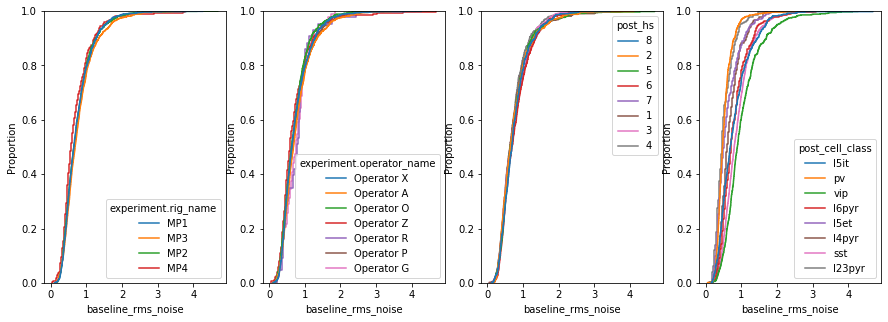

In [16]:
# let's investigate technical sources of noise

fig, ax = plt.subplots(1, 4, figsize=(15, 5))

sns.ecdfplot(data=noise, x='baseline_noise_stdev', hue='experiment.rig_name', ax=ax[0])
sns.ecdfplot(data=noise, x='baseline_noise_stdev', hue='experiment.operator_name', ax=ax[1])
sns.ecdfplot(data=noise, x='baseline_noise_stdev', hue='post_hs', ax=ax[2])
sns.ecdfplot(data=noise, x='baseline_noise_stdev', hue='post_cell_class', ax=ax[3])

Text(0.5, 4.389903537813321, 'Cell Subclass')

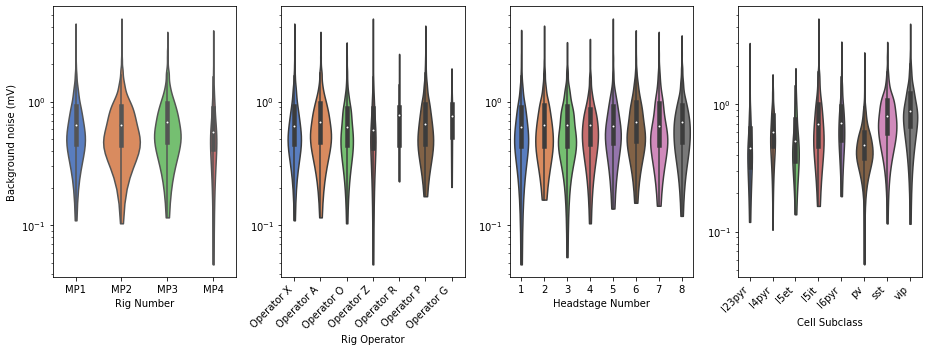

In [154]:
figD, ax = plt.subplots(1, 4, figsize=(13, 5))
cell_class_order = [cc for cc in cell_classes.values()]
# sns.boxplot(data=noise, y='baseline_noise_stdev', x='experiment.rig_name', ax=ax[0], order=['MP1', 'MP2', 'MP3', 'MP4'], 
#             fliersize=3)
sns.violinplot(data=noise, y='baseline_noise_stdev', x='experiment.rig_name', ax=ax[0], order=['MP1', 'MP2', 'MP3', 'MP4'], cut=0,
              scale='count', palette='muted')
ax1 = sns.violinplot(data=noise, y='baseline_noise_stdev', x='experiment.operator_name', ax=ax[1], cut=0, scale='count', palette='muted')
ax[1].set_xticklabels(ax1.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize='medium')
sns.violinplot(data=noise, y='baseline_noise_stdev', x='post_hs', ax=ax[2], order=['1', '2', '3', '4', '5', '6', '7', '8'],
              cut=0, scale='count', palette='muted')
ax3=sns.violinplot(data=noise, y='baseline_noise_stdev', x='post_cell_class', ax=ax[3], cut=0, scale='count', palette='muted',
                  order=cell_class_order)
_ = ax[3].set_xticklabels(ax3.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize='medium')
[axs.set_yscale('log') for axs in ax]
[axs.set_ylabel('') for axs in ax[1:]]
ax[0].set_ylabel('Background noise (mV)')
plt.tight_layout()
ax[0].set_xlabel('Rig Number')
ax[1].set_xlabel('Rig Operator')
ax[2].set_xlabel('Headstage Number')
ax[3].set_xlabel('Cell Subclass')

In [153]:
noise.describe()['baseline_noise_stdev']

count    5092.000000
mean        0.754235
std         0.436292
min         0.048295
25%         0.453648
50%         0.651305
75%         0.934381
max         4.685857
Name: baseline_noise_stdev, dtype: float64

In [18]:
from scipy import stats

stat, p_val = stats.kruskal(
    noise[noise['experiment.rig_name']=='MP1']['baseline_noise_stdev'].to_numpy(),
    noise[noise['experiment.rig_name']=='MP2']['baseline_noise_stdev'].to_numpy(),
    noise[noise['experiment.rig_name']=='MP3']['baseline_noise_stdev'].to_numpy(),
    noise[noise['experiment.rig_name']=='MP4']['baseline_noise_stdev'].to_numpy(),
    nan_policy='omit'
)
print(stat, p_val)

noise.groupby('experiment.rig_name').describe()['baseline_noise_stdev']

21.678817246835024 7.607883712277256e-05


,count,mean,std,min,25%,50%,75%,max
experiment.rig_name,,,,,,,,
MP1,1077.0,0.746543,0.419426,0.109651,0.454881,0.649208,0.925707,4.270570
MP2,2121.0,0.744801,0.424845,0.103727,0.448523,0.647876,0.924494,4.685857
MP3,1532.0,0.786040,0.455314,0.115850,0.475345,0.681669,0.974311,3.661016
MP4,362.0,0.697791,0.461220,0.048295,0.411190,0.567322,0.881833,3.767436


In [19]:
stat, p_val = stats.kruskal(
    noise[noise['experiment.operator_name']=='Operator A']['baseline_noise_stdev'].to_numpy(),
    noise[noise['experiment.operator_name']=='Operator G']['baseline_noise_stdev'].to_numpy(),
    noise[noise['experiment.operator_name']=='Operator O']['baseline_noise_stdev'].to_numpy(),
    noise[noise['experiment.operator_name']=='Operator P']['baseline_noise_stdev'].to_numpy(),
    noise[noise['experiment.operator_name']=='Operator R']['baseline_noise_stdev'].to_numpy(),
    noise[noise['experiment.operator_name']=='Operator X']['baseline_noise_stdev'].to_numpy(),
    noise[noise['experiment.operator_name']=='Operator Z']['baseline_noise_stdev'].to_numpy(),
    noise[noise['experiment.operator_name']=='']['baseline_noise_stdev'].to_numpy(),
    nan_policy='omit'
)
print(stat, p_val)
noise.groupby('experiment.operator_name').describe()['baseline_noise_stdev']

nan nan


,count,mean,std,min,25%,50%,75%,max
experiment.operator_name,,,,,,,,
Operator A,1537.0,0.785754,0.454888,0.115850,0.475429,0.681710,0.974254,3.661016
Operator G,93.0,0.772977,0.364495,0.204123,0.515091,0.757662,0.948759,1.853176
Operator O,911.0,0.710278,0.377590,0.103727,0.442304,0.625485,0.881917,3.004326
Operator P,1147.0,0.765254,0.443775,0.171647,0.455338,0.662126,0.952304,4.109169
Operator R,43.0,0.782768,0.405263,0.226301,0.445102,0.775847,0.910614,2.429729
Operator X,979.0,0.744280,0.424916,0.109651,0.450858,0.637507,0.920268,4.270570
Operator Z,382.0,0.716895,0.501925,0.048295,0.423963,0.584764,0.891103,4.685857


In [20]:
stat, p_val = stats.kruskal(
    noise[noise['post_hs']=='1']['baseline_noise_stdev'].to_numpy(),
    noise[noise['post_hs']=='2']['baseline_noise_stdev'].to_numpy(),
    noise[noise['post_hs']=='3']['baseline_noise_stdev'].to_numpy(),
    noise[noise['post_hs']=='4']['baseline_noise_stdev'].to_numpy(),
    noise[noise['post_hs']=='5']['baseline_noise_stdev'].to_numpy(),
    noise[noise['post_hs']=='6']['baseline_noise_stdev'].to_numpy(),
    noise[noise['post_hs']=='7']['baseline_noise_stdev'].to_numpy(),
    noise[noise['post_hs']=='8']['baseline_noise_stdev'].to_numpy(),
    nan_policy='omit'
)
print(stat, p_val)
noise.groupby('post_hs').describe()['baseline_noise_stdev']

12.967366717104596 0.07290749792995962


,count,mean,std,min,25%,50%,75%,max
post_hs,,,,,,,,
1,535.0,0.747395,0.475207,0.048295,0.439713,0.625722,0.907749,3.795471
2,672.0,0.752818,0.458516,0.161266,0.438781,0.641059,0.935623,4.109169
3,690.0,0.737296,0.392941,0.055292,0.437251,0.650550,0.923302,3.023203
4,614.0,0.723413,0.399486,0.103727,0.455634,0.641529,0.867146,3.208751
5,604.0,0.759935,0.473758,0.136613,0.465858,0.638397,0.916301,4.685857
6,701.0,0.789757,0.437744,0.152030,0.477371,0.686847,0.994415,3.767436
7,655.0,0.757522,0.439754,0.143862,0.448372,0.640242,0.971624,3.661016
8,621.0,0.761847,0.412511,0.119083,0.471001,0.682657,0.931659,3.427804


In [21]:
noise.groupby('post_cell_class').describe()['baseline_noise_stdev']

,count,mean,std,min,25%,50%,75%,max
post_cell_class,,,,,,,,
l23pyr,225.0,0.521782,0.303567,0.119083,0.321006,0.453020,0.647660,3.015194
l4pyr,238.0,0.677738,0.302250,0.103727,0.466224,0.604958,0.821916,1.710779
l5et,327.0,0.605236,0.339149,0.136613,0.358659,0.510030,0.770770,1.913707
l5it,521.0,0.802770,0.468165,0.158917,0.468710,0.692490,1.004976,4.685857
l6pyr,293.0,0.799411,0.409163,0.189497,0.519606,0.712213,0.965874,3.091272
pv,831.0,0.527469,0.244386,0.055292,0.378072,0.476965,0.609066,2.546107
sst,923.0,0.875953,0.406560,0.115850,0.588742,0.801818,1.072034,3.074703
vip,714.0,1.012321,0.544365,0.115144,0.667366,0.890613,1.227366,4.270570


In [149]:
from aisynphys.avg_response_fit import response_query, sort_responses
from aisynphys.data import PulseResponseList
from aisynphys.ui.scalebars import add_scalebar
from matplotlib import gridspec

example_pair = ('1550787701.841', ('2', '8')) #('1556746729.253', ('5', '1'))
expt = db.experiment_from_timestamp(example_pair[0])
pair = expt.pairs[example_pair[1]]

holding = -70
mode = 'ic'
n_spikes = [10, 50, 200]
s = db.session()

records = response_query(session=s, pair=pair)
prs = [rec[0] for rec in records]
sort_prs = sort_responses(prs)
qc_pass_resp = sort_prs[(mode, holding)]['qc_pass']
np.random.shuffle(qc_pass_resp)


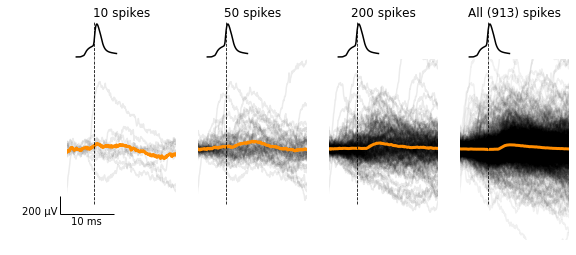

In [150]:
figA = plt.figure(figsize=(9, 4))
grid = gridspec.GridSpec(2, 4, height_ratios=[1, 5], hspace=0)
resp_ax = [figA.add_subplot(grid[1, i]) for i in range(4)]
spike_ax = [figA.add_subplot(grid[0, i]) for i in range(4)]
[ax.set_xlim(-5e-3, 15e-3) for ax in resp_ax]
[ax.set_ylim(-1e-3, 1e-3) for ax in resp_ax]
[ax.set_xlim(-5e-3, 15e-3) for ax in spike_ax]


for i, n_spike in enumerate(n_spikes):    
    n_prs = qc_pass_resp[:n_spike]
    pr_list = PulseResponseList(n_prs).post_tseries(align='spike', bsub=True)
    for trace in pr_list:
        resp_ax[i].plot(trace.time_values, trace.data, color=(0, 0, 0, 0.08))
    avg = PulseResponseList(n_prs).post_tseries(align='spike', bsub=True).mean()
    resp_ax[i].plot(avg.time_values, avg.data, color=(1, 0.55, 0), linewidth=3)
    spike_ax[i].set_title('%d spikes' % n_spike)

pr_list = PulseResponseList(qc_pass_resp).post_tseries(align='spike', bsub=True)
for trace in pr_list:
    resp_ax[-1].plot(trace.time_values, trace.data, color=(0, 0, 0, 0.06))
avg = PulseResponseList(qc_pass_resp).post_tseries(align='spike', bsub=True).mean()
resp_ax[-1].plot(avg.time_values, avg.data, color=(1, 0.55, 0), linewidth=3)
spike_ax[-1].set_title('All (%d) spikes' % len(pr_list))

spike = PulseResponseList(qc_pass_resp).pre_tseries(align='spike', bsub=True).mean()
[spike_ax[i].plot(spike.time_values, spike.data, color='k') for i in range(4)]

sb = add_scalebar(resp_ax[0], matchx=False, sizex=10e-3, labelx='10 ms', matchy=False, sizey=200e-6, labely='200 µV', loc='lower left',
                 bbox_to_anchor=(20, 27))
[axi.spines['right'].set_visible(False) for axi in resp_ax[1:]]
[axi.spines['top'].set_visible(False) for axi in resp_ax[1:]]
[axi.spines['bottom'].set_visible(False) for axi in resp_ax[1:]]
[axi.spines['left'].set_visible(False) for axi in resp_ax[1:]]
[axi.get_xaxis().set_visible(False) for axi in resp_ax[1:]]
[axi.get_yaxis().set_visible(False) for axi in resp_ax[1:]]

[axi.spines['right'].set_visible(False) for axi in spike_ax[0:]]
[axi.spines['top'].set_visible(False) for axi in spike_ax[0:]]
[axi.spines['bottom'].set_visible(False) for axi in spike_ax[0:]]
[axi.spines['left'].set_visible(False) for axi in spike_ax[0:]]
[axi.get_xaxis().set_visible(False) for axi in spike_ax[0:]]
[axi.get_yaxis().set_visible(False) for axi in spike_ax[0:]]
_ = [axi.axvline(0, ymin=0.2, ymax=1, ls='--', color='k', lw=0.8) for axi in resp_ax]
_ = [axi.axvline(0, ls='--', color='k', lw=0.8) for axi in spike_ax]

In [511]:
noise[noise['baseline_noise_stdev']>1000e-3][['post_cell_id', 'baseline_noise_stdev', 'n_ex_test_spikes', 'n_in_test_spikes']]

,post_cell_id,baseline_noise_stdev,n_ex_test_spikes,n_in_test_spikes
4,2870,1.608254,110,0
15,10089,1.004780,235,175
28,17561,1.863837,187,173
37,10712,1.187303,294,6
44,5804,1.513502,446,60
...,...,...,...,...
18203,11595,1.340747,659,122
18279,11884,1.459285,658,0
18280,11885,4.685857,146,0
18290,11899,1.212924,1134,60


In [71]:
low_cell_id = 17750
low_noise = noise[noise['post_cell_id']==low_cell_id]['baseline_noise_stdev'].iloc[0]
print(low_noise)
q = db.query(db.Baseline)
q = q.join(db.Recording, db.Baseline.recording_id==db.Recording.id)
q = q.join(db.Electrode, db.Recording.electrode_id==db.Electrode.id)
q = q.join(db.Cell, db.Cell.electrode_id==db.Electrode.id)
q = q.filter(db.Cell.id==low_cell_id).filter(db.Baseline.ex_qc_pass==True)

cell_baselines_low = q.all()
print(len(cell_baselines_low))

0.11514377515988689
2640


In [111]:
mid_cell_id = pair.post_cell_id
mid_noise = noise[noise['post_cell_id']==cell_id]['baseline_noise_stdev'].iloc[0]
print(mid_noise)
q = db.query(db.Baseline)
q = q.join(db.Recording, db.Baseline.recording_id==db.Recording.id)
q = q.join(db.Electrode, db.Recording.electrode_id==db.Electrode.id)
q = q.join(db.Cell, db.Cell.electrode_id==db.Electrode.id)
q = q.filter(db.Cell.id==cell_id).filter(db.Baseline.in_qc_pass==True)

cell_baselines_mid = q.all()

0.3951658613646834


In [72]:
high_cell_id = 11899
high_noise = noise[noise['post_cell_id']==high_cell_id]['baseline_noise_stdev'].iloc[0]
print(high_noise)
q = db.query(db.Baseline)
q = q.join(db.Recording, db.Baseline.recording_id==db.Recording.id)
q = q.join(db.Electrode, db.Recording.electrode_id==db.Electrode.id)
q = q.join(db.Cell, db.Cell.electrode_id==db.Electrode.id)
q = q.filter(db.Cell.id==high_cell_id).filter(db.Baseline.ex_qc_pass==True)

cell_baselines_high = q.all()
print(len(cell_baselines_high))

1.212924239499604
4583


In [28]:
from neuroanalysis.data import TSeriesList, TSeries
import random
n_traces = 100

low_traces = [TSeries(baseline.data, sample_rate=db.default_sample_rate, start_time=baseline.data_start_time) for baseline in 
              random.sample(cell_baselines_low, n_traces)]

mid_traces = [TSeries(baseline.data, sample_rate=db.default_sample_rate, start_time=baseline.data_start_time) for baseline in 
              random.sample(cell_baselines_mid, n_traces)]

high_traces = [TSeries(baseline.data, sample_rate=db.default_sample_rate, start_time=baseline.data_start_time) for baseline in 
              random.sample(cell_baselines_high, n_traces)]

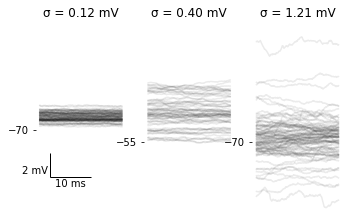

In [156]:
figB, ax = plt.subplots(1, 3, figsize=(5.5, 3.5))

[axi.spines['right'].set_visible(False) for axi in ax[0:]]
[axi.spines['top'].set_visible(False) for axi in ax[0:]]
[axi.spines['bottom'].set_visible(False) for axi in ax[0:]]
[axi.spines['left'].set_visible(False) for axi in ax[0:]]
[axi.get_xaxis().set_visible(False) for axi in ax[0:]]

for i, trace_list in enumerate([low_traces, mid_traces, high_traces]):
    for trace in trace_list:
        ax[i].plot(trace.time_values, trace.data*1e3, alpha=0.08, color='k')

ax[0].set_ylim(-77, -61)
ax[0].set_yticks([-70])
ax[0].set_title('σ = %0.2f mV' % low_noise)

ax[1].set_ylim(-61, -45)
ax[1].set_yticks([-55])
ax[1].set_title('σ = %0.2f mV' % mid_noise)
    
ax[2].set_ylim(-76, -60)
ax[2].set_yticks([-70])
ax[2].set_title('σ = %0.2f mV' % high_noise)

sb = add_scalebar(ax[0], matchx=False, sizex=10e-3, labelx='10 ms', matchy=False, sizey=2, labely='2 mV', loc='lower left',
                 bbox_to_anchor=(20, 30), hidey=False)


In [160]:
from aisynphys.ui.notebook import compose_svg_figure
import os

label_opts = {'size': '16pt', 'font': 'arial', 'weight': 'bold'}

figure_spec = [
    {'figure': figA, 'pos': (0, 20), 'label': 'A', 'label_opts': label_opts},
    {'figure': figB, 'pos': (575, 20), 'label': 'B', 'label_opts': label_opts},
    {'figure': figC, 'pos': (0, 250), 'label': 'C', 'label_opts': label_opts},
    {'figure': figD, 'pos': (0, 910), 'label': 'D', 'label_opts': label_opts},
]

compose_svg_figure(figure_spec, size=("10in", "13in"), filename=os.path.join('generated_svg', 'figureS14.svg'), display=True)

In [324]:
pre_spikes = pair_df.drop_duplicates(subset='pre_cell_id')
print(len(pre_spikes))
pre_spikes.head()

5128


,experiment_id,n_ex_test_spikes,pre_cell_id,n_in_test_spikes,post_cell_id,distance,has_synapse,lateral_distance,has_polysynapse,vertical_distance,...,experiment.target_region,experiment.internal,experiment.acsf,experiment.target_temperature,experiment.rig_name,experiment.operator_name,experiment.storage_path,experiment.ephys_file,experiment.acq_timestamp,experiment.meta
0,403,505,2865,0,2871,0.000047,False,0.000037,False,0.000030,...,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP1,Operator X,1492544244.802/slice_000/site_000,2017_04_18_124005.nwb,1.492546e+09,"{'lims_cell_cluster_id': 778355272, 'lims_ephy..."
1,403,445,2867,0,2865,0.000030,True,0.000025,False,0.000018,...,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP1,Operator X,1492544244.802/slice_000/site_000,2017_04_18_124005.nwb,1.492546e+09,"{'lims_cell_cluster_id': 778355272, 'lims_ephy..."
5,3092,15,17513,15,17512,0.000433,False,0.000038,False,0.000384,...,VisP,Standard K-Gluc,1.3mM Ca & 1mM Mg,32.0,MP1,Operator A,1558384039.475/slice_000/site_000,2019_05_20_133021-compressed.nwb,1.558385e+09,"{'lims_cell_cluster_id': 879405313, 'lims_ephy..."
9,403,540,2868,0,2865,0.000065,False,0.000061,False,0.000027,...,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP1,Operator X,1492544244.802/slice_000/site_000,2017_04_18_124005.nwb,1.492546e+09,"{'lims_cell_cluster_id': 778355272, 'lims_ephy..."
10,403,540,2869,0,2865,0.000049,False,0.000011,False,0.000049,...,VisP,Standard K-Gluc,2mM Ca & Mg,32.0,MP1,Operator X,1492544244.802/slice_000/site_000,2017_04_18_124005.nwb,1.492546e+09,"{'lims_cell_cluster_id': 778355272, 'lims_ephy..."


In [326]:
pre_spikes['max_spikes'] = pre_spikes.apply(lambda x: max(x['n_ex_test_spikes'], x['n_in_test_spikes']), axis=1)
pre_spikes.describe()['max_spikes']

count    5128.000000
mean      449.665562
std       274.415845
min        11.000000
25%       192.000000
50%       485.000000
75%       623.250000
max      1961.000000
Name: max_spikes, dtype: float64